In [1]:
# Package Imports
import pandas as pd
import plotly.express as px
import numpy as np
from geopy.geocoders import Nominatim
import json
from geojson_rewind import rewind
import plotly.graph_objects as go

pd.options.plotting.backend = "plotly"

## Data Importing
# Do not assign to imported variables!
acgr21 = pd.read_table("cohort2021.txt", dtype={'CountyCode': str, 'DistrictCode': str, 'SchoolCode': str}, na_values = '*', converters = {'*':0})
schoolZIP = pd.read_table("pubschls.txt", dtype={'CDSCode': str}, usecols = ['CDSCode', 'StatusType', 'Zip', 'Street', 'Latitude', 'Longitude'])
ZIPCodeIncome = pd.read_csv("ACSST5Y2020.S1903_data_with_overlays_2022-04-24T152354.csv", skiprows=1, converters = {'250,000+':250000}, usecols=["Geographic Area Name", "Estimate!!Median income (dollars)!!HOUSEHOLD INCOME BY RACE AND HISPANIC OR LATINO ORIGIN OF HOUSEHOLDER!!Households"])

In [2]:
# Extra code to show dataframes
pd.options.display.max_columns = 20
pd.options.display.max_rows = 34

In [3]:
## Data Cleaning and Combining Multiple Data Sources

# Filtering for the following conditions: All schools ("S" and "All" for charter and DASS) with a reporting category of total ("TA") while removing all entries with school code 0000000 or 1
acgr_21 = acgr21.replace('*', int(0)).fillna(0)
schools_acgr21 = acgr_21[(acgr_21["AggregateLevel"] == "S") & (acgr_21["CharterSchool"] == "All") & (acgr_21["DASS"] == "All") & (acgr_21["ReportingCategory"] == "TA") &
                        (acgr_21["SchoolCode"] != "0000000") & (acgr_21["SchoolCode"] != "0000001")]

# Separate various Series into sub DataFrames to cast type
schools_acgr21_counts = schools_acgr21.loc[:,['(Count' in i for i in schools_acgr21.columns]].astype(int)
schools_acgr21_rates =  schools_acgr21.loc[:,['(Rate' in i for i in schools_acgr21.columns]].astype(float)
cohortStudents = schools_acgr21["CohortStudents"].astype(int)
schoolNames = schools_acgr21["SchoolName"].astype(str)

# Cleaning the school_info entries
schoolZIP_cleaned = schoolZIP[(schoolZIP["Zip"] != "No Data") & (schoolZIP["StatusType"] == "Active")].astype(str) # Removes inactive entries + no Data and casts as string for string method
schoolZIP_cleaned["Zip5"] = schoolZIP_cleaned["Zip"].str[:5] #Cut out +4 in ZIP Code 
#school_info.drop(["Zip"], axis=1,inplace=True)
#school_geodata = school_ZIP[["Street", "Latitude", "Longitude"]]

#school_info = pd.concat([school_ZIP, school_geodata], axis=1)
#school_info.columns = ["CDSCode", "Zip", "Latitude", "Longitude"]

# Some of the school geodata is missing, which involves fixing up by manually checking: 
geolocator = Nominatim(user_agent="sageshadows7@gmail.com")
missingGeoData = schoolZIP_cleaned[(schoolZIP_cleaned["Latitude"]== "No Data")].index
for i in missingGeoData: 
    addy = schoolZIP_cleaned.loc[i]["Street"] + ', ' + str(schoolZIP_cleaned.loc[i]["Zip"])
    location = geolocator.geocode(addy)
    schoolZIP_cleaned.at[i, "Latitude"] = location.latitude
    schoolZIP_cleaned.at[i, "Longitude"] = location.longitude
# We can now cast variable typing and create a new df with the relevant information
school_info = pd.concat([schoolZIP_cleaned[["CDSCode", "Zip5"]].astype('int64'),schoolZIP_cleaned[["Latitude", "Longitude"]].astype('float64')], axis=1)
school_info.columns = ["CDSCode", "Zip", "Latitude", "Longitude"]

# Subsequently, use median income data and sanitize this data. 
ZIPCode_Income = ZIPCodeIncome.replace('250,000+', int(250000)).replace('2,500-', int(2500)).replace('-', int(0)).fillna(0)
ZIPCode_Income.columns = ["Geographic Area Name", "Median Income (USD)"]
ZIPCode_Income["Zip"] = ZIPCode_Income["Geographic Area Name"].str[5:]
ZIPCode_Income.drop(["Geographic Area Name"], axis=1,inplace=True)
ZIPCode_Income = ZIPCode_Income[["Zip", "Median Income (USD)"]].astype('int64')

## Data Joining after Subsequent Cleaning Steps

# Prettyifying up the data frame. First, concatenating the Country + District + School Code for a CDS Code, then creating a connection between school ID and ZIP, then ZIP and Income
CDS_codes = schools_acgr21["CountyCode"]+schools_acgr21["DistrictCode"]+schools_acgr21["SchoolCode"]
CDS_codes = CDS_codes.rename("CDSCode").astype('int64')

schools_geographic = pd.DataFrame({"Copy_Index": pd.Series(CDS_codes.index.values)})
schools_geographic["CDSCode"] = CDS_codes.values

schools_acgr21_geo = pd.merge(schools_geographic,school_info, how='left', indicator=True) # Combines school info with ZIP Code
badEntries = schools_acgr21_geo.loc[schools_acgr21_geo["_merge"] == "left_only"] # After merges, check the school entries that did not get assigned a ZIP code/median income

# Remove the entries that do not have a ZIP code/median income
schools_acgr21_geo.drop(badEntries.index, inplace = True)
schools_acgr21_geo["Zip"] = schools_acgr21_geo["Zip"].astype("int64")
schools_acgr21_counts.drop(badEntries["Copy_Index"], inplace = True)
schools_acgr21_rates.drop(badEntries["Copy_Index"], inplace = True)
cohortStudents.drop(badEntries["Copy_Index"], inplace = True)
schoolNames.drop(badEntries["Copy_Index"], inplace = True)
schools_acgr21_geo.drop(["_merge"], axis=1, inplace=True)

acgr21_organized = pd.merge(schools_acgr21_geo,ZIPCode_Income, how='left') # Combines schools plus ZIP code with income information
acgr21_organized.set_index("Copy_Index", inplace= True)
acgr21_organized.index.name = None
acgr21_organized.fillna(0, inplace=True)

acgr21_cleaned = pd.concat([acgr21_organized,schoolNames,cohortStudents,schools_acgr21_counts,schools_acgr21_rates], axis=1)
# Set zip to str for subsequent geomapping
acgr21_cleaned["Zip"] = acgr21_cleaned["Zip"].astype("str")
# Filter the organized data to come to a final dataset by removing entries with 0s that corresponded to NaN. 
# pd.fillna was called for both income and studentcohort, so set to > 0. 
acgr21_cleaned = acgr21_cleaned[(acgr21_cleaned["CohortStudents"] > 0) & (acgr21_cleaned["Median Income (USD)"] > 0)] #289 schools had NaN entries in either #students or median income that were removed. 

# Additional calculated metrics
acgr21_cleaned["UC/CSU Ready (% of Cohort)"] = (acgr21_cleaned["Met UC/CSU Grad Req's (Count)"]/acgr21_cleaned["CohortStudents"]*100).round(1)

In [4]:
# Locating individual entries identified from SPLOM
# acgr21_cleaned.loc[108062]

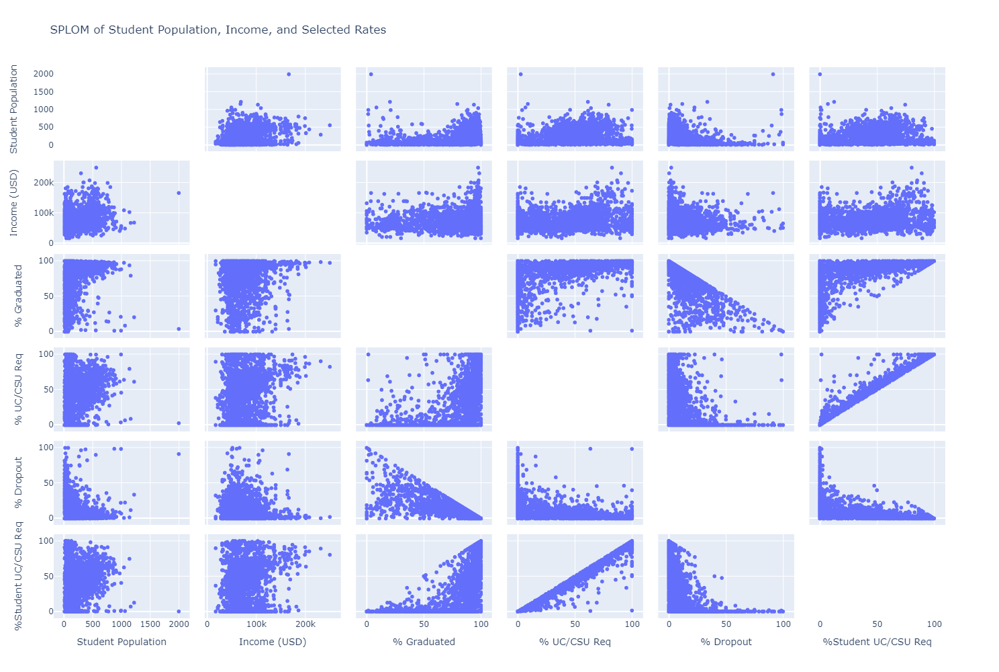

In [5]:
## First pass at looking at data
fig = px.scatter_matrix(acgr21_cleaned, 
        dimensions = ["CohortStudents", "Median Income (USD)", "Regular HS Diploma Graduates (Rate)", "Met UC/CSU Grad Req's (Rate)", "Dropout (Rate)", "UC/CSU Ready (% of Cohort)"],
        title = "SPLOM of Student Population, Income, and Selected Rates", 
        labels = {"CohortStudents": "Student Population", "Median Income (USD)": "Income (USD)", "Regular HS Diploma Graduates (Rate)": "% Graduated", "Met UC/CSU Grad Req's (Rate)": "% UC/CSU Req", "UC/CSU Ready (% of Cohort)": "%Student UC/CSU Req", "Dropout (Rate)": "% Dropout"}, 
        width=1000, height=1000, hover_data = ["CDSCode", acgr21_cleaned.index])
fig.update_traces(diagonal_visible=False)
fig.show()
fig.write_html("SPLOM of Preliminary Data.html", include_plotlyjs='cdn')
# From the scatter_matrix, some outliers are revealed as follows: 
# 1. The largest outlier is the 1 school with 1998 students: Five Keys Independence HS (SF Sheriff's) (#208337) which will be removed. 
# 2. Two additional outliers can be seen in New Opportunities Charter (#108062) and Family First Charter (#107995) which are both for adult continuing education. 

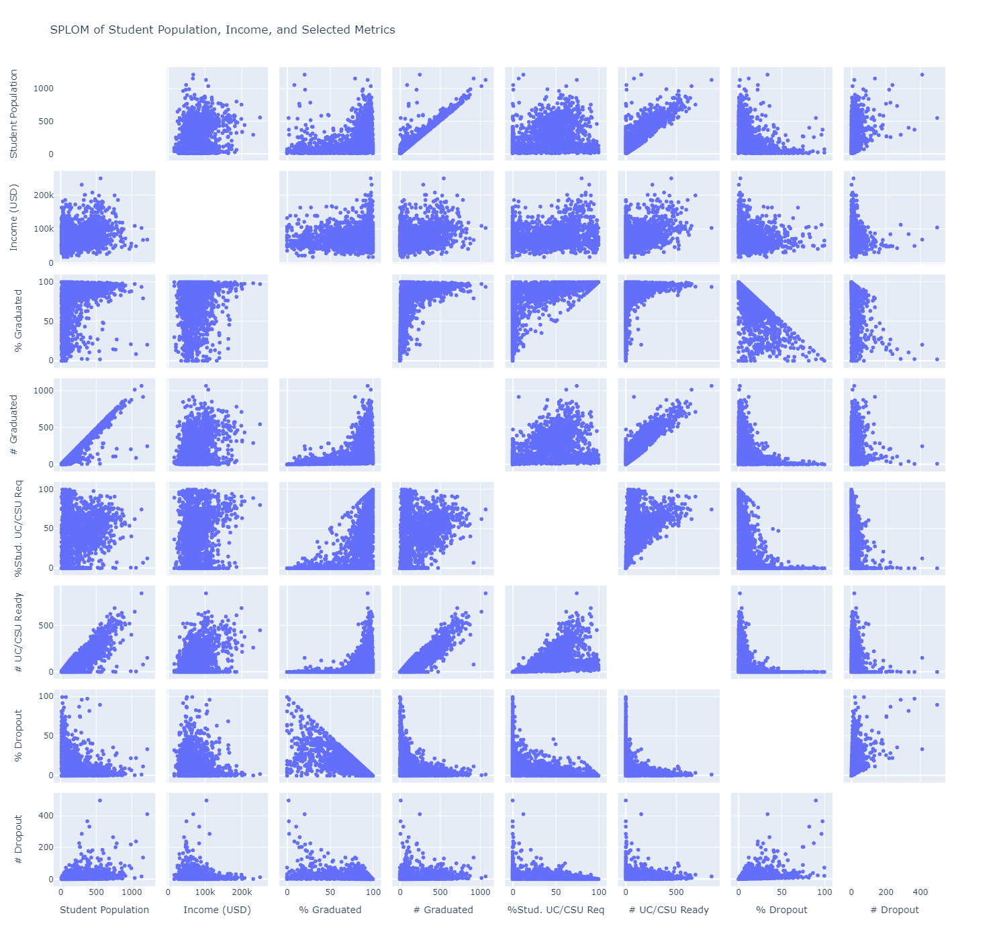

In [6]:
# Additional filtering after looking at SPLOM
acgr21_cleaned_filtered = acgr21_cleaned.drop([107995, 108062, 208337])
fig2 = px.scatter_matrix(acgr21_cleaned_filtered, 
        dimensions = ["CohortStudents", "Median Income (USD)", "Regular HS Diploma Graduates (Rate)", "Regular HS Diploma Graduates (Count)", "UC/CSU Ready (% of Cohort)", "Met UC/CSU Grad Req's (Count)", "Dropout (Rate)", "Dropout (Count)"],
        title = "SPLOM of Student Population, Income, and Selected Metrics", 
        labels = {"CohortStudents": "Student Population", 
                  "Median Income (USD)": "Income (USD)", 
                  "Regular HS Diploma Graduates (Rate)": "% Graduated",
                  "Regular HS Diploma Graduates (Count)": "# Graduated", 
                  "Met UC/CSU Grad Req's (Count)": "# UC/CSU Ready", 
                  "UC/CSU Ready (% of Cohort)": "%Stud. UC/CSU Req", 
                  "Dropout (Rate)": "% Dropout", 
                  "Dropout (Count)": "# Dropout"}, 
        width=1400, height=1400, hover_data = ["CDSCode", acgr21_cleaned_filtered.index])
fig2.update_traces(diagonal_visible=False)
fig2.show()
fig2.write_html("SPLOM of Student Population, Income, and Selected Metrics.html", include_plotlyjs='cdn')

In [7]:
## Geospatial Figures Data Imports (Takes a while, do not run too much)
# Original data from https://github.com/OpenDataDE/State-zip-code-GeoJSON and simplified with https://mapshaper.org/ down to .5%
with open("ca_california_zip_codes_geo.min.json", "r") as response: # Original geoJSON data
    zipcodes_complex = json.load(response)
with open("ca_california_zip_codes_geo_simplified.min.json", "r") as response: # Simplified from mapshaper
    zipcodes = json.load(response)
zipcodes = rewind(zipcodes, rfc7946=False)

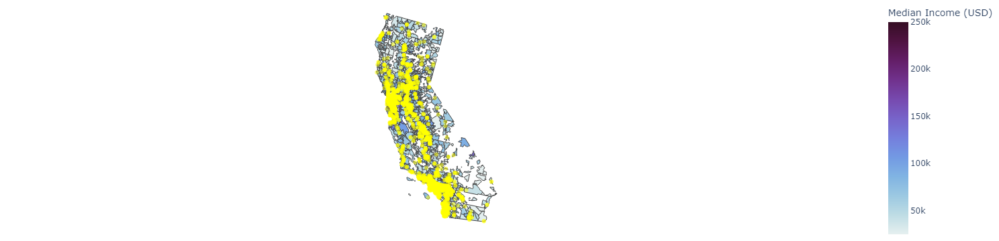

In [8]:
ZIPCode_Income_Map = ZIPCode_Income
ZIPCode_Income_Map["Zip"] = ZIPCode_Income_Map["Zip"].astype("str")
CA_map = px.choropleth(ZIPCode_Income_Map, 
        geojson=zipcodes,
        locations='Zip', 
        featureidkey = "properties.ZCTA5CE10", 
        color='Median Income (USD)', 
        scope='usa',
        range_color=(25000, 250000),
        color_continuous_scale="Dense")
CA_map.update_geos(fitbounds="locations", visible=False)
CA_map.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
CA_map.write_html("Map of CA Household Incomes by ZCTAs.html", include_plotlyjs='cdn')

schools_of_interest = acgr21_cleaned_filtered
school_map = px.scatter_geo(schools_of_interest, 
                            lat="Latitude", 
                            lon="Longitude", 
                            scope='usa',
                            #size="Dropout (Rate)", size_max=10,
                            center= {'lat': 36.7783, 'lon': -119.4179},
                            opacity=0.5,
                            #color="Regular HS Diploma Graduates (Rate)",
                            hover_data={"Latitude": False, 
                                        "Longitude": False, 
                                        "CohortStudents": True, 
                                        "Regular HS Diploma Graduates (Count)": True,
                                        "Met UC/CSU Grad Req's (Count)": True, 
                                        "Regular HS Diploma Graduates (Rate)": True, 
                                        "UC/CSU Ready (% of Cohort)": True,
                                        "SchoolName": True},
                            labels = {"CohortStudents": "Students", 
                                      "Regular HS Diploma Graduates (Count)": "Graduates",
                                      "Met UC/CSU Grad Req's (Count)": "UC/CSU Qualified Graduates", 
                                      "Regular HS Diploma Graduates (Rate)": "Graduates [% of Students]", 
                                      "UC/CSU Ready (% of Cohort)": "%Stud. UC/CSU Req", 
                                      "SchoolName": "School Name"},
                            hover_name=schools_of_interest.index)
school_map.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
school_map.update_traces(marker_color="Yellow")
school_map.write_html("Map of CA High Schools.html", include_plotlyjs='cdn')

CA_map_overlay = go.Figure(CA_map)
CA_map_overlay.add_trace(school_map.data[0])
#CA_map_overlay.update_layout(title_text="Map of CA High Schools with ZTCA Income", title_x=0.40,title_y=.995)
#CA_map_overlay.write_html("Map of CA High Schools with ZTCA Income.html", include_plotlyjs='cdn')
CA_map_overlay.show()

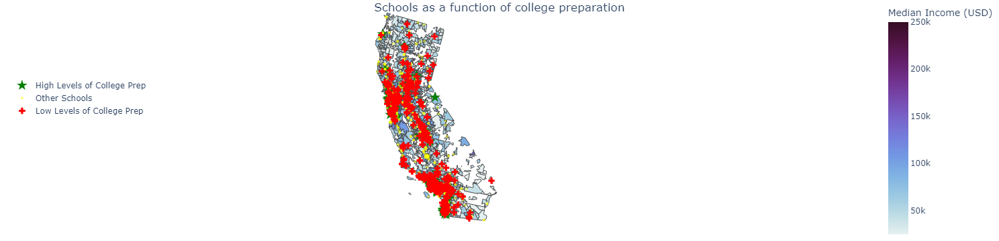

In [9]:
CA_map_overlay2 = go.Figure(CA_map)
schools_college_prep = acgr21_cleaned_filtered[(acgr21_cleaned_filtered["UC/CSU Ready (% of Cohort)"] > 80)]
school_map_college_prep = px.scatter_geo(schools_college_prep, 
                            lat="Latitude", 
                            lon="Longitude", 
                            scope='usa',
                            #size="Met UC/CSU Grad Req's (Count)", size_max=10,
                            center= {'lat': 36.7783, 'lon': -119.4179},
                            #color="Regular HS Diploma Graduates (Rate)",
                            opacity=1,
                            hover_data={"Latitude": False, 
                                        "Longitude": False, 
                                        "CohortStudents": True, 
                                        "Regular HS Diploma Graduates (Count)": True,
                                        "Met UC/CSU Grad Req's (Count)": True, 
                                        "Regular HS Diploma Graduates (Rate)": True, 
                                        "UC/CSU Ready (% of Cohort)": True,
                                        "SchoolName": True},
                            labels = {"CohortStudents": "Students", 
                                      "Regular HS Diploma Graduates (Count)": "Graduates",
                                      "Met UC/CSU Grad Req's (Count)": "UC/CSU Qualified Graduates", 
                                      "Regular HS Diploma Graduates (Rate)": "Graduates [% of Students]", 
                                      "UC/CSU Ready (% of Cohort)": "%Stud. UC/CSU Req", 
                                      "SchoolName": "School Name"},
                            hover_name=schools_college_prep.index)
school_map_college_prep.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
school_map_college_prep.update_traces(marker_symbol="star", marker_color="Green", marker_size=12, name="High Levels of College Prep", showlegend=True)

# Filters for schools that have reported UC/CSU Grad Requirements (Count > 0) and have a low UC/CSU Req/Cohort Student Ratio (< 20%) OR have a very low graduation rate (<35%) with no UC/CSU Grad Reports
schools_low_college_prep = pd.concat([acgr21_cleaned_filtered[(acgr21_cleaned_filtered["UC/CSU Ready (% of Cohort)"] < 20) & 
                                           (acgr21_cleaned_filtered["Met UC/CSU Grad Req's (Count)"] > 0)],
                                      acgr21_cleaned_filtered[(acgr21_cleaned_filtered["Regular HS Diploma Graduates (Rate)"] < 25) & 
                                           (acgr21_cleaned_filtered["Met UC/CSU Grad Req's (Count)"] == 0)]])
school_map_low_college_prep = px.scatter_geo(schools_low_college_prep, 
                            lat="Latitude", 
                            lon="Longitude", 
                            scope='usa',
                            #size="Met UC/CSU Grad Req's (Count)", size_max=10,
                            center= {'lat': 36.7783, 'lon': -119.4179},
                            #color="Regular HS Diploma Graduates (Rate)",
                            opacity=1,
                            hover_data={"Latitude": False, 
                                        "Longitude": False, 
                                        "CohortStudents": True, 
                                        "Regular HS Diploma Graduates (Count)": True,
                                        "Met UC/CSU Grad Req's (Count)": True, 
                                        "Regular HS Diploma Graduates (Rate)": True, 
                                        "UC/CSU Ready (% of Cohort)": True,
                                        "SchoolName": True},
                            labels = {"CohortStudents": "Students", 
                                      "Regular HS Diploma Graduates (Count)": "Graduates",
                                      "Met UC/CSU Grad Req's (Count)": "UC/CSU Qualified Graduates", 
                                      "Regular HS Diploma Graduates (Rate)": "Graduates [% of Students]", 
                                      "UC/CSU Ready (% of Cohort)": "%Stud. UC/CSU Req", 
                                      "SchoolName": "School Name"},
                            hover_name=schools_low_college_prep.index)
school_map_low_college_prep.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
school_map_low_college_prep.update_traces(marker_symbol="cross", marker_color="Red", marker_size=8, name="Low Levels of College Prep", showlegend=True)


# Plot the rest of the schools
schools_remainder = acgr21_cleaned_filtered[~acgr21_cleaned_filtered.isin(pd.concat([schools_college_prep, schools_low_college_prep]))].dropna(how = 'all')
school_map_remainder = px.scatter_geo(schools_remainder, 
                            lat="Latitude", 
                            lon="Longitude", 
                            scope='usa',
                            #size="Met UC/CSU Grad Req's (Count)", size_max=10,
                            center= {'lat': 36.7783, 'lon': -119.4179},
                            #color="Regular HS Diploma Graduates (Rate)",
                            opacity=0.5,
                            hover_data={"Latitude": False, 
                                        "Longitude": False, 
                                        "CohortStudents": True, 
                                        "Regular HS Diploma Graduates (Count)": True,
                                        "Met UC/CSU Grad Req's (Count)": True, 
                                        "Regular HS Diploma Graduates (Rate)": True, 
                                        "UC/CSU Ready (% of Cohort)": True,
                                        "SchoolName": True},
                            labels = {"CohortStudents": "Students", 
                                      "Regular HS Diploma Graduates (Count)": "Graduates",
                                      "Met UC/CSU Grad Req's (Count)": "UC/CSU Qualified Graduates", 
                                      "Regular HS Diploma Graduates (Rate)": "Graduates [% of Students]", 
                                      "UC/CSU Ready (% of Cohort)": "%Stud. UC/CSU Req", 
                                      "SchoolName": "School Name"},
                            hover_name=schools_remainder.index)
school_map_remainder.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
school_map_remainder.update_traces(marker_symbol="circle", marker_color="Yellow", marker_size=4, name="Other Schools", showlegend=True)

CA_map_overlay2.add_trace(school_map_college_prep.data[0])
CA_map_overlay2.add_trace(school_map_remainder.data[0])
CA_map_overlay2.add_trace(school_map_low_college_prep.data[0])

CA_map_overlay2.update_layout(title={'y':0.985,'x':0.5,'xanchor': 'center','yanchor': 'top', 'text':"Schools as a function of college preparation"}, legend={"yanchor":"bottom","y":0.5,"xanchor":"left","x":0.01})
CA_map_overlay2.show()
CA_map_overlay2.write_html("Schools as College Prep.html", include_plotlyjs='cdn')

In [10]:
# Check to see if all schools are represented.

print("The number of excellent college preparatory schools is: {}".format(schools_college_prep.shape[0]))
print("The number of low college preparatory schools is: {}".format(schools_low_college_prep.shape[0]))
print("The number of remaining schools is: {}".format(schools_remainder.shape[0]))
print("The number of total schools in the original cleaned dataset is: {}".format(acgr21_cleaned_filtered.shape[0]))
print("Does this add up? {}".format(schools_remainder.shape[0]+schools_college_prep.shape[0]+schools_low_college_prep.shape[0] == acgr21_cleaned_filtered.shape[0]))

The number of excellent college preparatory schools is: 185
The number of low college preparatory schools is: 450
The number of remaining schools is: 1590
The number of total schools in the original cleaned dataset is: 2225
Does this add up? True
